In [ ]:
#mount the drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
# Google Drive path where coursework material is available
GOOGLE_DRIVE_PATH_AFTER_MYDRIVE = 'Dissertation'
GOOGLE_DRIVE_PATH = os.path.join('drive', 'My Drive', GOOGLE_DRIVE_PATH_AFTER_MYDRIVE)
print(os.listdir(GOOGLE_DRIVE_PATH))

['accepted_2013_to_2018_filtered.csv', 'FINAL_unbalancedData.csv', 'Final_balanced_data.csv', 'Cleaned_data.csv', 'accepted_2013_to_2018_latest1.csv', 'accepted_2013_to_2018_latest.csv', 'accepted_2007_to_2018q4.csv.zip', 'Cleaned_data_dummy.csv', '3_Filter Individual_loans_EDA_ and_cleaning.ipynb', 'y_data.csv', 'x_data.csv', 'FINAL_balancedData.csv', 'FINAL_forModeling.csv', 'ANN_model.joblib', 'Decsion_tree_model.joblib', 'Random_fores.joblib', '4_Individual_loans_hypothesisTesting_and_undersampling.ipynb', 'FINAL_balancedData_testing.csv', 'XGBoost_model.joblib', 'Untitled0.ipynb', 'Logistic_Regression.joblib', 'Model_5_ANN.ipynb', 'Model_4_XGBoost.ipynb', 'Model_3_Random_Forest.ipynb', 'Model_1_Logistic_regression.ipynb', 'Random_forest_model_feature_selection_and_encoding.ipynb', 'XGBoost_model_feature_selection_and_encoding.ipynb', '1_Filter_data_2013_to_2018.ipynb', '2_Filter_data_on_Loan_status.ipynb', '4_latest_Individual_loans_hypothesisTesting.ipynb', 'Copy of 3_Filter Indi

In [ ]:
#Import required libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from sklearn.model_selection import GridSearchCV, StratifiedKFold
import joblib
from sklearn.metrics import accuracy_score,  f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import StratifiedShuffleSplit

In [ ]:
#load dependent variable y and independent variables X
X = pd.read_csv(os.path.join(GOOGLE_DRIVE_PATH, 'x_data.csv'))
y = pd.read_csv(os.path.join(GOOGLE_DRIVE_PATH, 'y_data.csv'))

In [ ]:
#split train and test data in 80:20 ratio
x_train, x_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, stratify = y, random_state = 129)

In [ ]:
#load the saved Random forest model
rf = joblib.load('drive/My Drive/Dissertation/Random_fores.joblib')

In [ ]:
#make the predictions and print performance report
pred = rf.predict(x_test)
print("Classification Report:") #
print(classification_report(y_test, pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.73      0.77    146697
           1       0.56      0.70      0.62     74335

    accuracy                           0.72    221032
   macro avg       0.70      0.71      0.70    221032
weighted avg       0.74      0.72      0.72    221032



In [ ]:
#checking the accuracy
pred = rf.predict(x_test)
accuracy = accuracy_score(y_test,pred)
print(accuracy)

0.7172671830323211


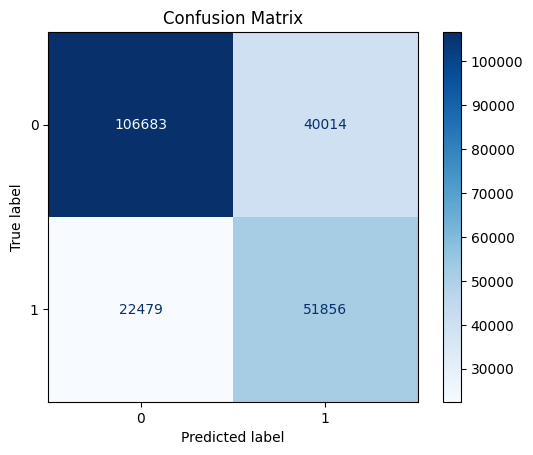

In [ ]:
#plot confusion matrix
cm_rf= confusion_matrix(y_test, pred)
disp_rf = ConfusionMatrixDisplay(confusion_matrix=cm_rf)
disp_rf.plot(cmap='Blues', values_format='d')
plt.title('Confusion Matrix')
plt.show()

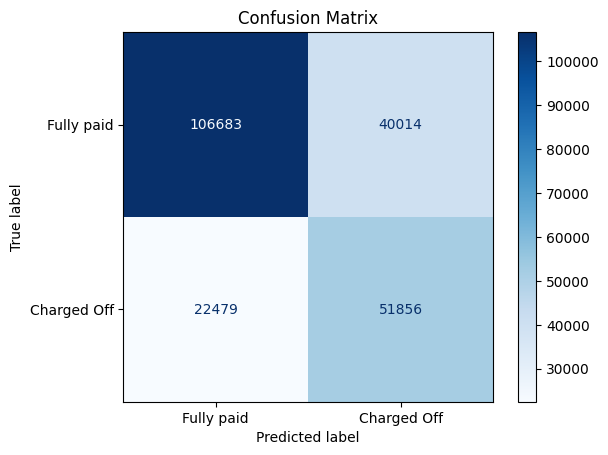

In [ ]:
#plot confusion matrix
cm_rf= confusion_matrix(y_test, pred)
disp_rf = ConfusionMatrixDisplay(confusion_matrix=cm_rf, display_labels=['Fully paid', 'Charged Off'])
disp_rf.plot(cmap='Blues', values_format='d')
plt.title('Confusion Matrix')
plt.show()

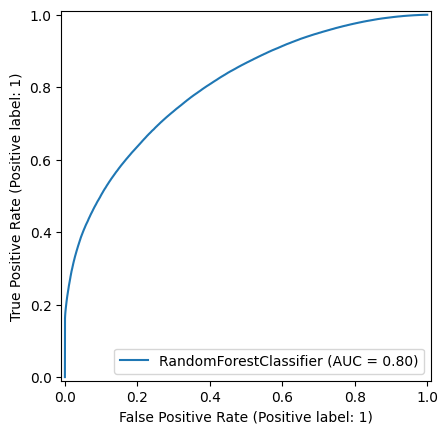

In [ ]:
#AUC on train data
RocCurveDisplay.from_estimator(rf, x_train, y_train)

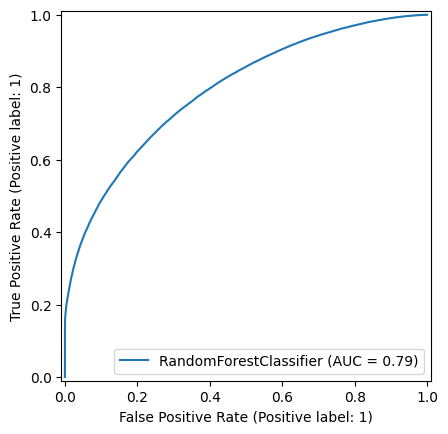

In [ ]:
#roc curve for test data
RocCurveDisplay.from_estimator(rf, x_test, y_test)

Text(0, 0.5, 'Feature Importance')

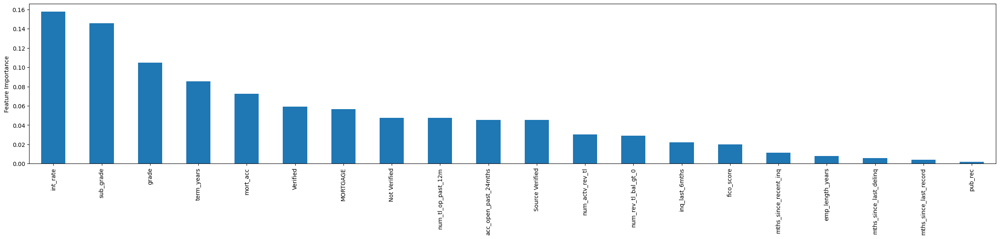

In [ ]:
feature_importance_rf =rf.feature_importances_
feature_importance_rf = pd.Series(feature_importance_rf, index = X.columns).sort_values(ascending=False)
feature_importance_rf.plot(kind = 'bar', figsize=(30,5))
plt.ylabel("Feature Importance")

In [ ]:
#-----------------------------------------------------------Explainability of Random forest model using SHAP and LIME-------------------------------------------

In [ ]:
#Install shap library
!pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 10.5 MB/s eta 0:00:00


In [ ]:
import shap
shap.initjs() #load Java script visualisation code to the colab notebook

In [ ]:
#create explainer object of the Random forest model
explainer = shap.TreeExplainer(rf)

In [ ]:
x_train.tail(10) #print last 10 observations of train data

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
640694,10.56,7,3,0.0,1,58.0,0.0,1,3.0,0,667.0,3.0,6.0,0,58.0,3.0,1.0,0,11.0,0.0
471341,10.99,8,5,0.0,1,46.0,3.0,0,6.0,1,707.0,7.0,4.0,1,999.0,7.0,0.0,0,8.0,3.0
24048,9.17,5,3,0.0,1,77.0,3.0,1,3.0,0,692.0,6.0,10.0,0,999.0,6.0,0.0,0,8.0,0.0
340120,10.49,7,3,1.0,1,999.0,2.0,0,4.0,0,777.0,2.0,8.0,0,999.0,2.0,0.0,1,3.0,0.0
1007834,26.30,24,5,1.0,4,999.0,4.0,1,6.0,0,677.0,5.0,2.0,0,999.0,5.0,0.0,0,4.0,0.0
811713,12.12,7,3,0.0,1,53.0,2.0,0,4.0,0,712.0,7.0,10.0,1,999.0,7.0,0.0,0,12.0,1.0
478183,23.99,27,5,0.0,5,999.0,2.0,0,3.0,0,672.0,5.0,1.0,1,999.0,5.0,0.0,0,5.0,0.0
803529,15.41,15,3,0.0,3,39.0,3.0,0,6.0,1,667.0,3.0,10.0,0,49.0,3.0,1.0,1,4.0,1.0
875173,9.67,5,3,0.0,1,19.0,0.0,0,1.0,1,727.0,1.0,2.0,1,999.0,1.0,0.0,0,5.0,2.0
93036,16.02,14,3,0.0,2,75.0,3.0,0,7.0,1,697.0,6.0,10.0,0,999.0,6.0,0.0,1,10.0,5.0


In [ ]:
#take sample of last 250 observations of train data
samples = x_train.tail(250)

In [ ]:
#create shap values of 250 sample data
shap_values = explainer.shap_values(samples, check_additivity=False, approximate=False)


In [ ]:
#check the shape of shap value produced
shap_values.shape

(250, 20, 2)

In [ ]:
#we need shap values with regards to positive class that is "charged off"
shap_values_pos = shap_values[:, :, 1]

In [ ]:
#check the shape of shap values again
shap_values_pos.shape

(250, 20)

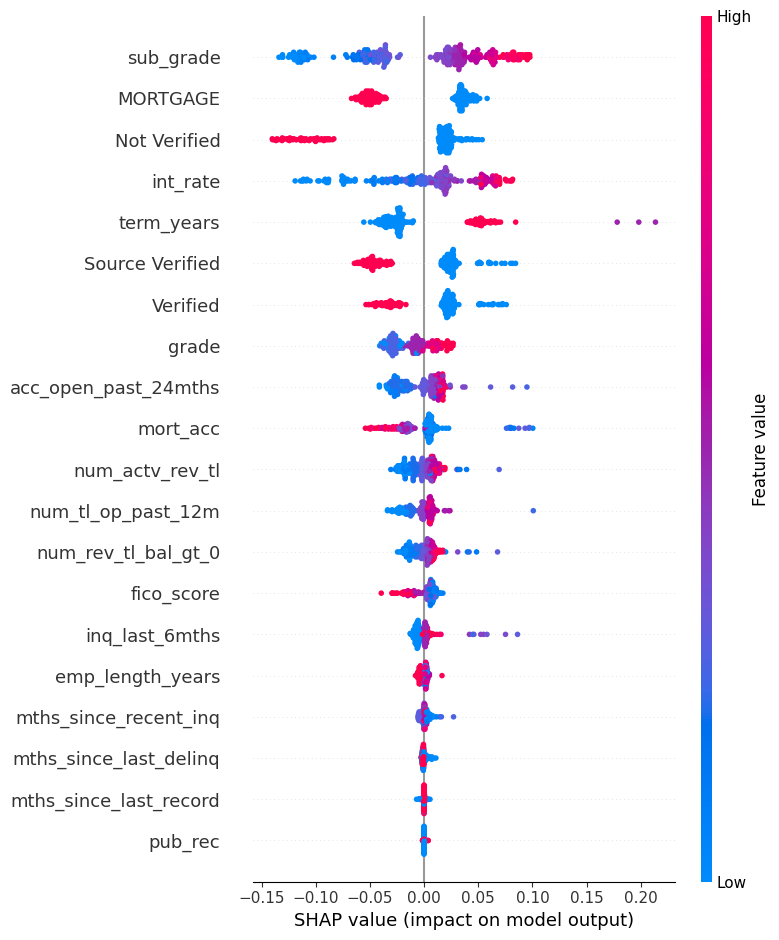

In [ ]:
#plot the summary plot of 250 sample data
shap.summary_plot(shap_values_pos, samples, feature_names=X.columns)

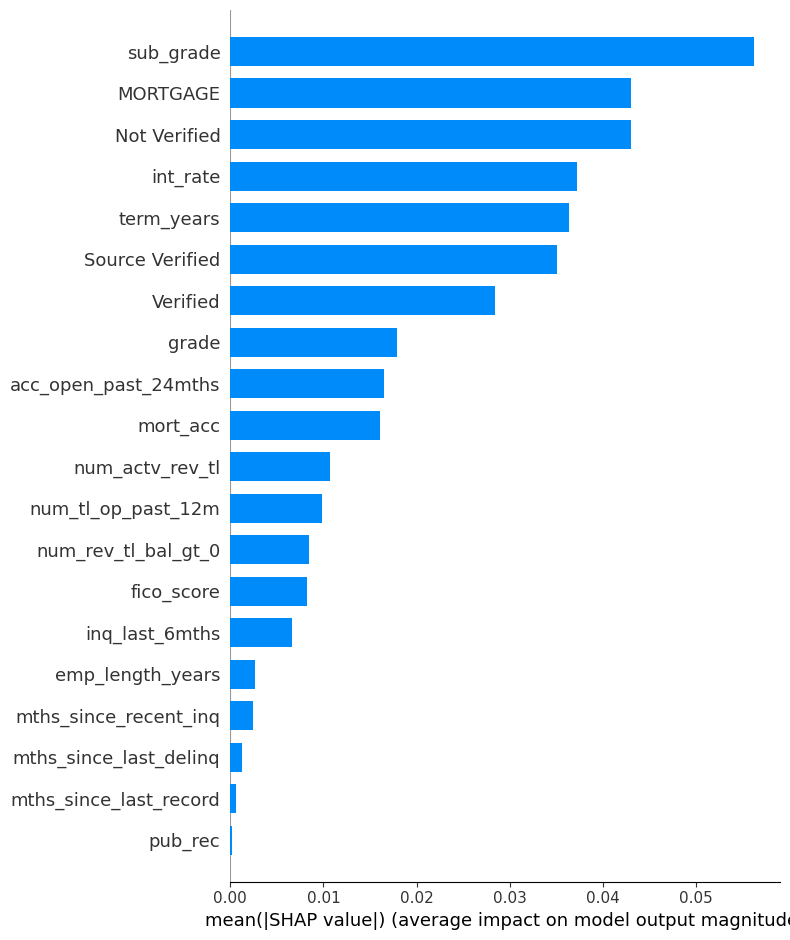

In [ ]:
#plot the bar chart for SHAP values which define the feature importance of the model using shapely values
plt.figure(figsize=(5,5))
shap.summary_plot(shap_values_positive, samples, feature_names=X.columns, plot_type ='bar')

In [ ]:
#Above XAI is the test sample for Global SHAP analysis for 250 sample data

In [ ]:
#Now will perform local explanation by taking few random samples of data

In [ ]:
#**********************************************************Sample 1*****************************************************************************
sample_1_x = x_test.iloc[[22]]
sample_1_y = y_test.iloc[[22]]
sample_1_y_pred = pred[[22]]

In [ ]:
print(sample_1_x) # random single observation
print(sample_1_y) #fully paid loan means y = 0
print(f'loan status predicted : {sample_1_y_pred}') #predictions are y_pred = 0

        int_rate  sub_grade  term_years  inq_last_6mths  grade  \
216556     12.29         10           3             1.0      2   

        mths_since_last_delinq  num_tl_op_past_12m  Not Verified  \
216556                     8.0                 1.0             1   

        acc_open_past_24mths  MORTGAGE  fico_score  num_rev_tl_bal_gt_0  \
216556                   2.0         0       677.0                  6.0   

        emp_length_years  Source Verified  mths_since_last_record  \
216556               0.0                0                   999.0   

        num_actv_rev_tl  pub_rec  Verified  mths_since_recent_inq  mort_acc  
216556              6.0      0.0         0                    6.0       0.0  
        loan_status
216556            0
loan status predicted : [0]


In [ ]:
x_test.shape #define the shape, it has 20 features

(221032, 20)

In [ ]:
sample_1_x.shape

(1, 20)

In [ ]:
#testing SHAP local explanations
single_value_test

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
60762,15.99,14,3,1.0,2,999.0,3.0,0,4.0,0,677.0,7.0,0.0,1,999.0,7.0,0.0,0,4.0,0.0


In [ ]:
single_value_test = x_test.tail(1)

In [ ]:
# SHAP value for single obsevation for testing
shap.initjs()
shap_values_single = explainer.shap_values(single_value_test, approximate=False, check_additivity=False)
shap_values_positive_single = shap_values_single[:, :, 1]

In [ ]:
shap.initjs()
#shap force plot for test single observation
shap.force_plot(explainer.expected_value[0], shap_values_positive_single, single_value, feature_names=X.columns)


In [ ]:
#shap value for sample 1
shap.initjs()
shap_values_sample1 = explainer.shap_values(sample_1_x, approximate=False, check_additivity=False)
shap_values_positive_sample1 = shap_values_sample1[:, :, 1]

In [ ]:
shap.initjs()
#Smaple 1: shap force plot for explanation
shap.force_plot(explainer.expected_value[0], shap_values_positive_sample1, sample_1_x, feature_names=X.columns)


In [ ]:
#****************************************Sample2**************************************
sample_2_x = x_test.iloc[[440]]
sample_2_y = y_test.iloc[[440]]
sample_2_y_pred = pred[[440]]
print(sample_2_x)
print(sample_2_y) # default/ charged off which means 1
print(f'loan status predicted : {sample_2_y_pred}') #predictions also default


        int_rate  sub_grade  term_years  inq_last_6mths  grade  \
741270     15.05         13           5             0.0      2   

        mths_since_last_delinq  num_tl_op_past_12m  Not Verified  \
741270                    74.0                 1.0             0   

        acc_open_past_24mths  MORTGAGE  fico_score  num_rev_tl_bal_gt_0  \
741270                   1.0         0       687.0                  7.0   

        emp_length_years  Source Verified  mths_since_last_record  \
741270               6.0                0                   999.0   

        num_actv_rev_tl  pub_rec  Verified  mths_since_recent_inq  mort_acc  
741270              7.0      0.0         1                    5.0       1.0  
        loan_status
741270            1
loan status predicted : [1]


In [ ]:
#shap plot
shap.initjs()
shap_values_sample2 = explainer.shap_values(sample_2_x, approximate=False, check_additivity=False)
shap_values_positive_sample2 = shap_values_sample2[:, :, 1]
shap.initjs()
shap.force_plot(explainer.expected_value[0], shap_values_positive_sample2, sample_2_x, feature_names=X.columns)

In [ ]:
sample_2_x # show sample 2

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
741270,15.05,13,5,0.0,2,74.0,1.0,0,1.0,0,687.0,7.0,6.0,0,999.0,7.0,0.0,1,5.0,1.0


In [ ]:
# perturbated main features to test the sample in model, for validation
sample_2_x_test = sample_2_x.copy()
sample_2_x_test['MORTGAGE'] =1
sample_2_x_test['term_years'] =3

In [ ]:
sample_2_test = rf.predict(sample_2_x_test)
print(sample_2_test) # based on the details produced by forceplot , it says there is 60% probability that the used will default and the important features are Mortgage and term so we changed those variable to see what random forest will predict.
#it has predicted it to fully paid, which validates SHAP

[0]


In [ ]:
#**********************************************************************Sample3**********************************************************************************
sample_3_x = x_test.iloc[[600]]
sample_3_y = y_test.iloc[[600]]
sample_3_y_pred = pred[[600]]
print(sample_3_x)
print(sample_3_y) #it is FUlly paid
print(f'loan status predicted : {sample_3_y_pred}') #predicted as default

        int_rate  sub_grade  term_years  inq_last_6mths  grade  \
854383     14.65         14           5             3.0      2   

        mths_since_last_delinq  num_tl_op_past_12m  Not Verified  \
854383                    40.0                 3.0             0   

        acc_open_past_24mths  MORTGAGE  fico_score  num_rev_tl_bal_gt_0  \
854383                   4.0         1       687.0                  5.0   

        emp_length_years  Source Verified  mths_since_last_record  \
854383               4.0                1                   999.0   

        num_actv_rev_tl  pub_rec  Verified  mths_since_recent_inq  mort_acc  
854383              5.0      0.0         0                    0.0       1.0  
        loan_status
854383            0
loan status predicted : [1]


In [ ]:
#SHAP force plot for sample 3
shap.initjs()
shap_values_sample3 = explainer.shap_values(sample_3_x, approximate=False, check_additivity=False)
shap_values_positive_sample3 = shap_values_sample3[:, :, 1]
shap.initjs()
shap.force_plot(explainer.expected_value[0], shap_values_positive_sample3, sample_3_x, feature_names=X.columns)
#55% probabilty that it is default, due to term 5 and subgrade 14 (which is C2) and 45% perobability that it is fully paid on right in bluemainly due to source verified is 1 and Mortgage =1


In [ ]:
#To experiment , perturbated main features which define the main predictions as per the above shap plot,so that model predict 'default':1
sample_3_x_test = sample_3_x.copy()
sample_3_x_test['MORTGAGE'] =0


In [ ]:
#validated 2nd sample
sample_3_test = rf.predict(sample_3_x_test)
print(sample_3_test)

[1]


In [ ]:
sample_3_x_test = sample_3_x.copy()
sample_3_x_test['term_years'] =3

In [ ]:
sample_3_test = rf.predict(sample_3_x_test)
print(sample_3_test)

[0]


In [ ]:
single_value

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
60762,15.99,14,3,1.0,2,999.0,3.0,0,4.0,0,677.0,7.0,0.0,1,999.0,7.0,0.0,0,4.0,0.0


In [ ]:
#-----------------------------SHAP Global for 1%, 2% and 5% of data----------------------

In [ ]:
#function to get the sample of data by peroviding ratio as an attribute
def stratified_sample_func(X, y, sample_size):

    combined_df = pd.concat([X, y], axis=1) #combined the dataframe, as existing have sepearte dependent and independent variables
    target_col = combined_df.columns[-1]
    strat_sample = combined_df.groupby(target_col, group_keys=False).apply(lambda x: x.sample(frac=sample_size)) #stratified sampling


    X_sample_df = strat_sample.iloc[:, :-1] # seperate into dependent and independent features
    y_sample_df = strat_sample.iloc[:, -1]

    return X_sample_df, y_sample_df

In [ ]:
#different ratios(1,2,5%) of subsample of data is produced below
X_sample_5, y_sample_5 = stratified_sample_func(x_train, y_train, 0.05) # Get 5% stratified sample data
X_sample_2, y_sample_2 = stratified_sample_func(x_train, y_train, 0.02) # Get 2% stratified sample data
X_sample_1, y_sample_1 = stratified_sample_func(x_train, y_train, 0.01) # Get 1% stratified sample data


In [ ]:
y_train.value_counts() #value count of original  data

,count
loan_status,
0,586785
1,297341


In [ ]:
#shap value of 5% of data
shap_values_5percent = explainer.shap_values(X_sample_5, approximate=False, check_additivity=False)

In [ ]:
shap_values_positive_5percent = shap_values_5percent[:, :, 1] #positive(default class) shap values for 5 percent of data

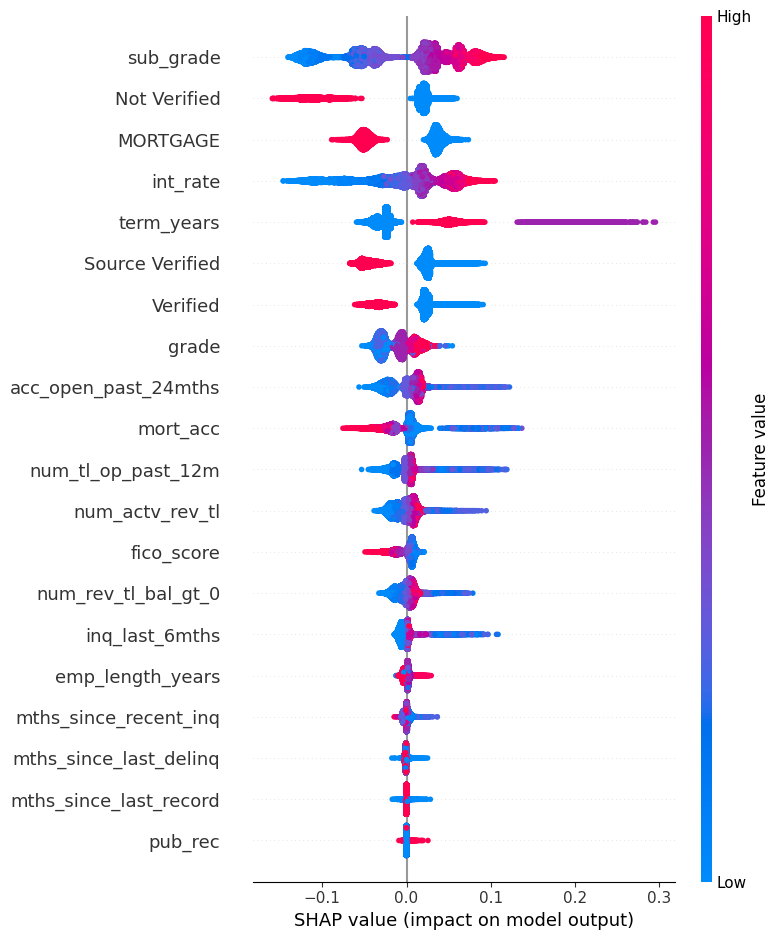

In [ ]:
#Summary plot of 5% of shapely values produced for global explanation
shap.summary_plot(shap_values_positive_5percent, X_sample_5, feature_names=X.columns) # 5% data 3 hr 46 mins 43 sec

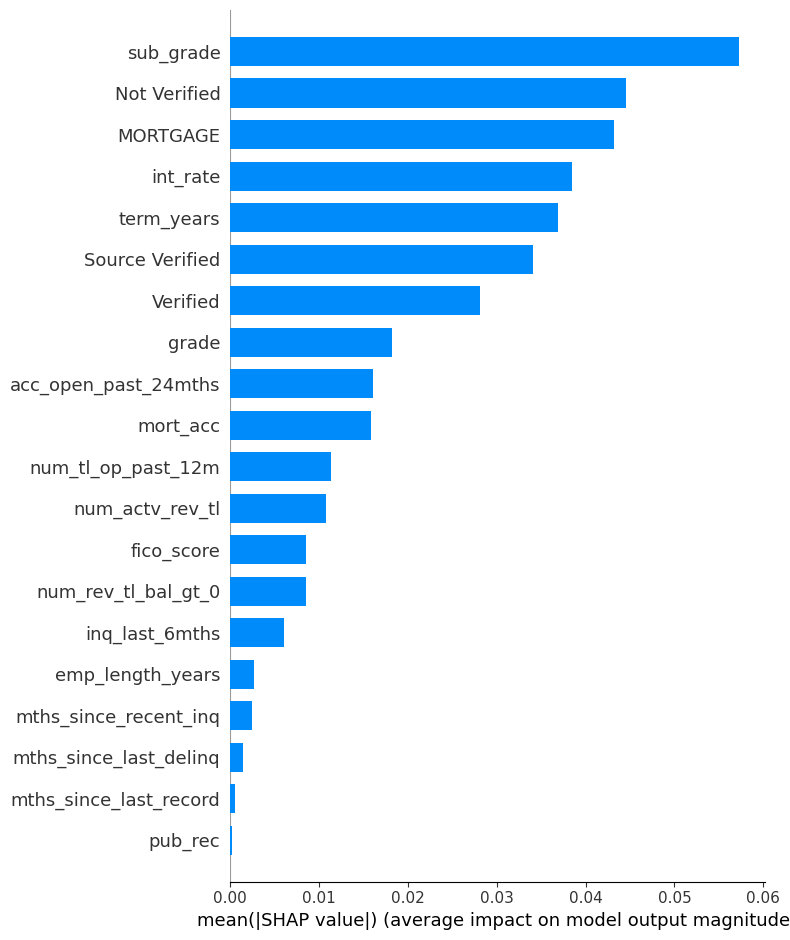

In [ ]:
# bar plot for feature importance produces using Shapely values of 5% of complete data
plt.figure(figsize=(5,5))
shap.summary_plot(shap_values_positive_5percent, X_sample_5, feature_names=X.columns, plot_type ='bar')

In [ ]:
shap_values_2percent = explainer.shap_values(X_sample_2, approximate=False, check_additivity=False) #shap value of 2% of data
shap_values_positive_2percent = shap_values_2percent[:, :, 1] #positive(default class) shap values for 2 percent of data

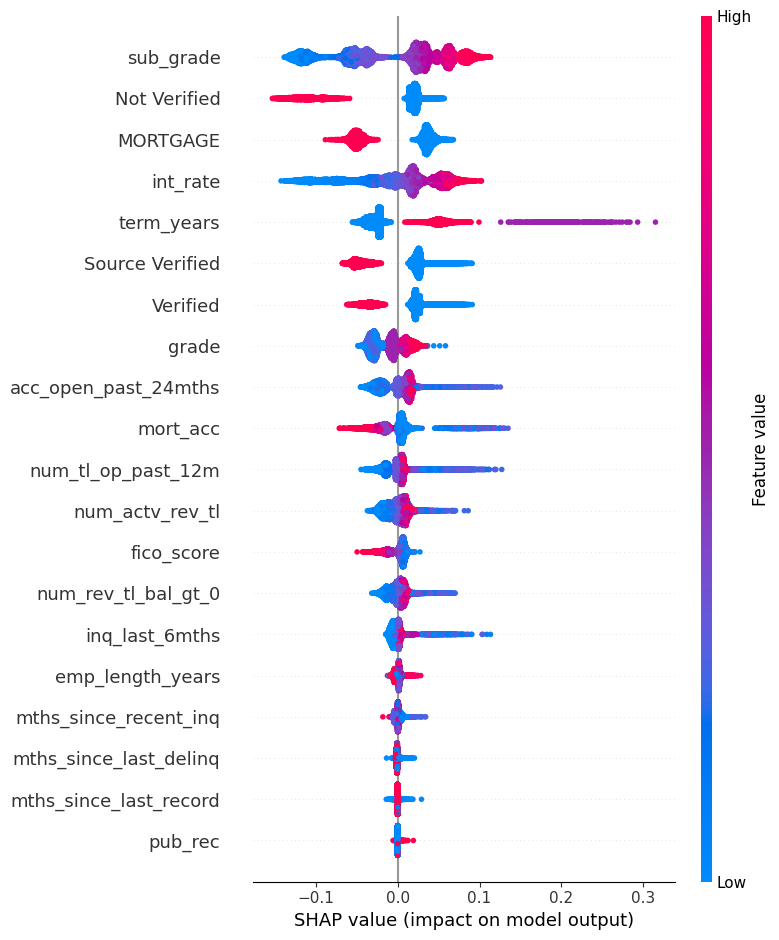

In [ ]:
#Summary plot of 2% of shapely values produced for global explanation
shap.summary_plot(shap_values_positive_2percent, X_sample_2, feature_names=X.columns) #2% data , total time taken is 1hr 30 mins to produce the results

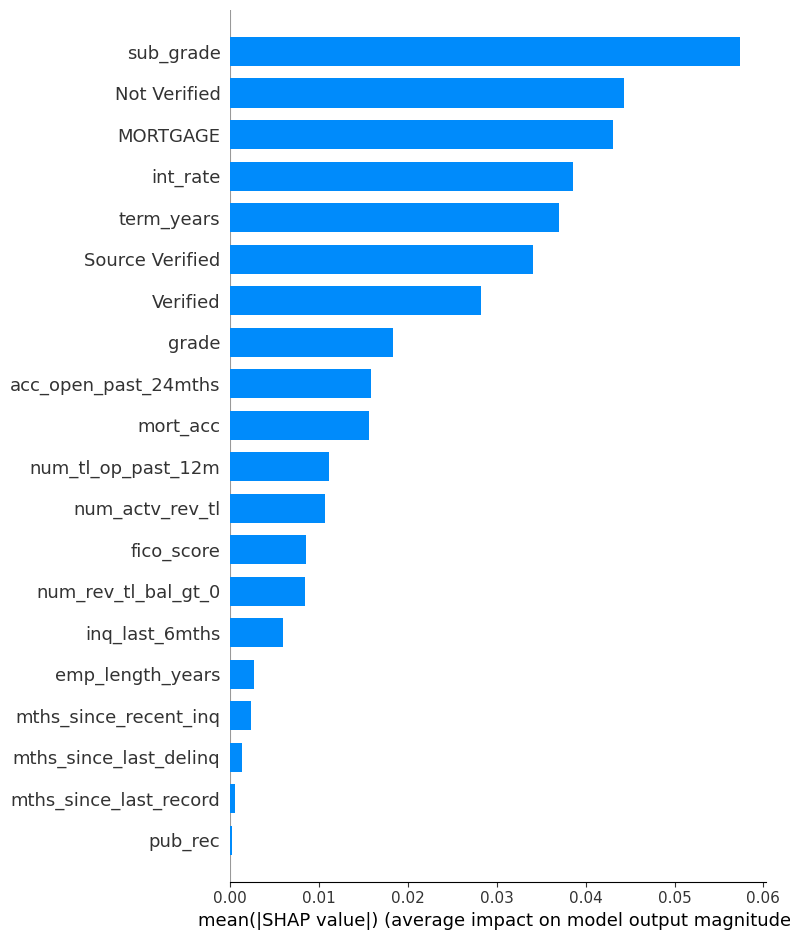

In [ ]:
# bar plot for feature importance produces using Shapely values of 2% of complete data
plt.figure(figsize=(5,5))
shap.summary_plot(shap_values_positive_2percent, X_sample_2, feature_names=X.columns, plot_type ='bar')

In [ ]:
shap_values_1percent = explainer.shap_values(X_sample_1, approximate=False, check_additivity=False) #shap value of 1% of data
shap_values_positive_1percent = shap_values_2percent[:, :, 1] #positive(default class) shap values for 1 percent of data

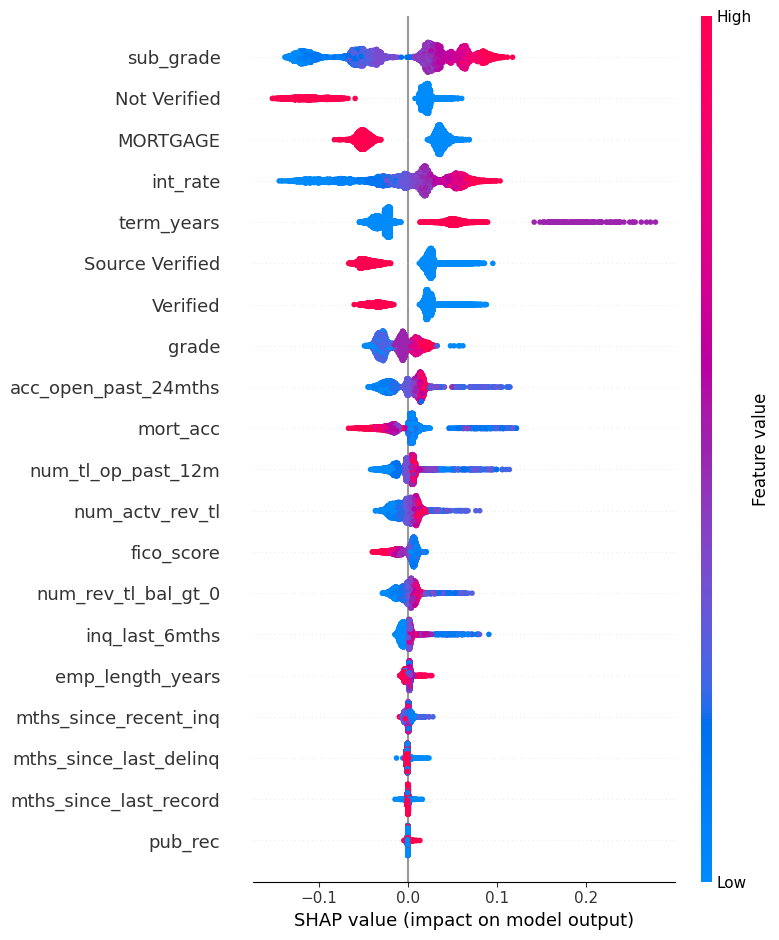

In [ ]:
shap.summary_plot(shap_values_positive_1percent, X_sample_1, feature_names=X.columns) #1% Data , total time taken to excecute is 45 mins

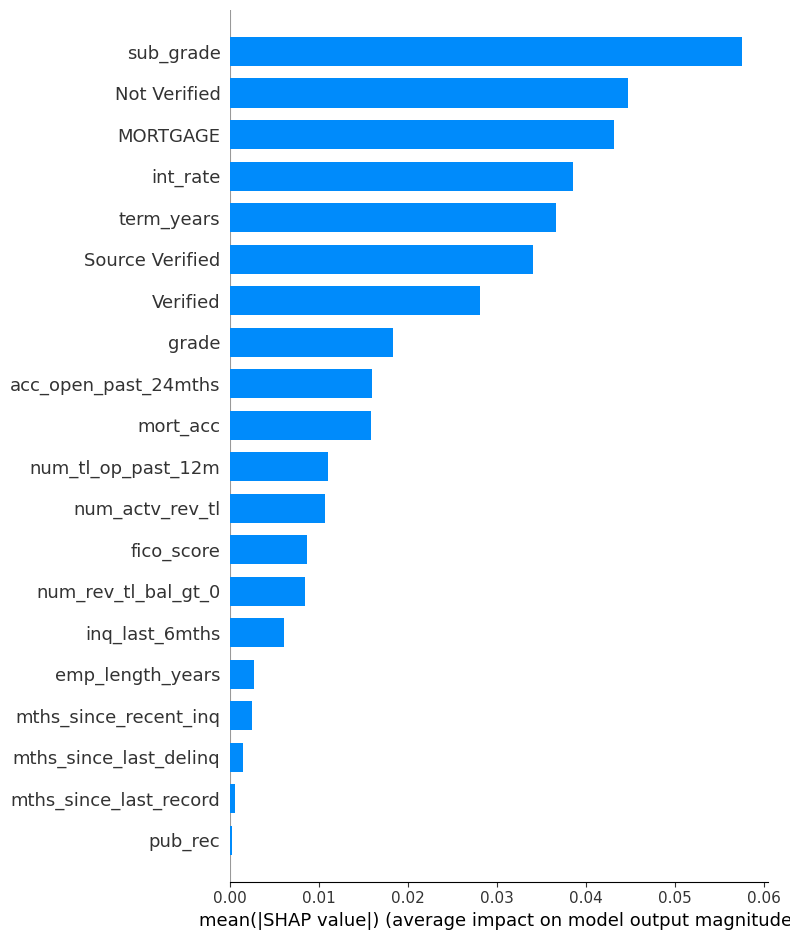

In [ ]:
# bar plot for feature importance produces using Shapely values of 1% of complete data
plt.figure(figsize=(5,5))
shap.summary_plot(shap_values_positive_1percent, X_sample_1, feature_names=X.columns, plot_type ='bar')

In [ ]:
#********************************LIME implementation on Random forest model**********************************************

In [ ]:
#Install Lime
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=10f91a7e70c814eb0f0e9fb644f13de057429e7dc363cb7818154fe3dba08a29
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
import lime
from lime import lime_tabular
#import lime

In [ ]:
samples_lime = x_train.tail(500) #take 500 sample of data

In [ ]:
x_train.head(2)

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
658486,11.49,9,3,0.0,1,999.0,2.0,1,3.0,0,692.0,5.0,7.0,0,999.0,5.0,0.0,0,20.0,0.0
80012,7.89,4,3,0.0,0,999.0,0.0,1,0.0,1,742.0,2.0,10.0,0,999.0,2.0,0.0,0,5.0,1.0


In [ ]:
cat_col=['grade', 'Not Verified','MORTGAGE','Source Verified','Verified'] #define categorical variables in the data

In [ ]:
interpretor = lime_tabular.LimeTabularExplainer( training_data= np.array(samples_lime),
                                                feature_names=x_train.columns,
                                                 mode = 'classification',categorical_names=cat_col)

In [ ]:
x_train.head(2)

,int_rate,sub_grade,term_years,inq_last_6mths,grade,mths_since_last_delinq,num_tl_op_past_12m,Not Verified,acc_open_past_24mths,MORTGAGE,fico_score,num_rev_tl_bal_gt_0,emp_length_years,Source Verified,mths_since_last_record,num_actv_rev_tl,pub_rec,Verified,mths_since_recent_inq,mort_acc
658486,11.49,9,3,0.0,1,999.0,2.0,1,3.0,0,692.0,5.0,7.0,0,999.0,5.0,0.0,0,20.0,0.0
80012,7.89,4,3,0.0,0,999.0,0.0,1,0.0,1,742.0,2.0,10.0,0,999.0,2.0,0.0,0,5.0,1.0


In [ ]:
# Sample 1:

In [ ]:
#explanation with 50,00 default on sample 1
exp_1 = interpretor.explain_instance(
    data_row = x_test.iloc[22],
    predict_fn= rf.predict_proba,

)
exp_1.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation for 10,000 sample 1
exp_2 = interpretor.explain_instance(
    data_row = x_test.iloc[22],
    predict_fn= rf.predict_proba, num_samples =10000
)
exp_2.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation for 1000 sample 1
exp_3 = interpretor.explain_instance(
    data_row = x_test.iloc[22],
    predict_fn= rf.predict_proba, num_samples =1000
)
exp_3.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation for 2500 samples on sample 1
exp = interpretor.explain_instance(
    data_row = x_test.iloc[22], #new data
    predict_fn= rf.predict_proba, num_samples =2500
)
exp.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#Sample 2
#explanation with 2500 sample data on sample 2
exp_21= interpretor.explain_instance(
    data_row = x_test.iloc[440],
    predict_fn= rf.predict_proba, num_samples =2500
)
exp_21.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation with default sample data on sample 2
exp_22 = interpretor.explain_instance(
    data_row = x_test.iloc[440],
    predict_fn= rf.predict_proba
)
exp_22.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation with 10,000 sample data on sample 2
exp_23 = interpretor.explain_instance(
    data_row = x_test.iloc[440], #new data
    predict_fn= rf.predict_proba, num_samples =10000
)
exp_23.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#explanation with 1000 sample data on sample 2
exp_24 = interpretor.explain_instance(
    data_row = x_test.iloc[440], #new data
    predict_fn= rf.predict_proba, num_samples =1000
)
exp_24.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#Sample 3

In [ ]:
#explanation with 1000 sample data on sample 3
#Random tests for analysis
exp_31= interpretor.explain_instance(
    data_row = x_test.iloc[500],
    predict_fn= rf.predict_proba, num_samples =1000
)
exp_31.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#sample 4

In [ ]:
exp_41 = interpretor.explain_instance(
    data_row = x_test.iloc[600],
    predict_fn= rf.predict_proba, num_samples =1000
)
exp_41.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
exp_42 = interpretor.explain_instance(
    data_row = x_test.iloc[600],
    predict_fn= rf.predict_proba, num_samples =2500
)
exp_42.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
exp_tests = interpretor.explain_instance(
    data_row = x_test.iloc[440],
    predict_fn= rf.predict_proba
)
exp_tests.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
exp_tests= interpretor.explain_instance(
    data_row = x_test.iloc[440],
    predict_fn= rf.predict_proba, num_samples =10000
)
exp_tests.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

In [ ]:
#Note1: 3 itteration tests for Lime are conducted on default values, which may not be same if run again as it changes on every run
#Note2 : Default sample data explanations in Lime are explained in report, which also differ everytime it runs
#Note 3: Overall Lime explanation will vary a little which is explained in report due to the nature of Lime explained in report discussion part